# **Análise dos acidentes na cidade de Porto Alegre**

---



In [5]:
import pandas as pd

df = pd.read_csv("/content/cat_acidentes.csv", sep=';')

In [7]:
df.head(3)

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2023-11-01 01:33:25,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2023-11-01 01:33:25,170.0,0.0,2018-01-01 00:00:00,1,0,0,0,0,1,...,-51.214455,-30.122420,R CASEMIRO DE SOUZA,NaN,ATROPELAMENTO,SEGUNDA-FEIRA,00:30:00.0000000,NOITE,SUL,NaN
2,2023-11-01 01:33:25,2617.0,0.0,2018-01-01 00:00:00,0,0,0,0,0,1,...,-51.203106,-30.073318,AV PROF OSCAR PEREIRA,NaN,COLISÃO,SEGUNDA-FEIRA,07:55:00.0000000,DIA,SUL,NaN


In [2]:
df.shape

(73560, 1)

In [8]:
df = df.dropna(subset=['latitude', 'longitude'], how='any')

In [25]:
import folium
from folium.plugins import HeatMap

mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
coordenadas = list(zip(df.latitude, df.longitude))
mapa_calor = HeatMap(coordenadas,radius=9,blur=10)
mapa.add_child(mapa_calor)

mapa

In [26]:
from folium.plugins import MarkerCluster

mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
mapa_cluster = MarkerCluster(coordenadas)
mapa.add_child(mapa_cluster)

mapa

In [12]:
# numero de mortes na coluna mortes
mortes = df['mortes'].sum()
mortes

184

In [13]:
# numero de mortes na coluna morte_post
mortes_pos = df['morte_post'].sum()
mortes_pos

190

In [14]:
# Analisando o total de morte no periodo
total_mortes = mortes + mortes_pos
total_mortes

374

In [18]:
# transformando a coluna data em tipo de datetime
# obtendo quantas colunas por ano temos no nosso dataframe

df['data'] = pd.to_datetime(df['data'], errors='coerce')
df
df_ano = df['data'].dt.year.value_counts()
df_ano

2022    13325
2019    12444
2023    11743
2021    11699
2018    10319
2020     2894
2102        1
Name: data, dtype: int64

In [20]:
# deletando a coluna com o erro apresentado
df_ano = df_ano.drop(2102)

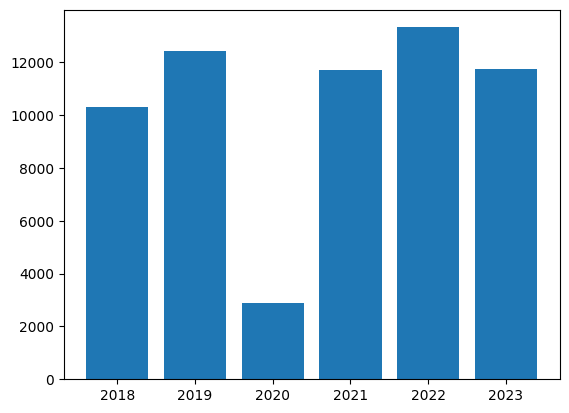

In [21]:
import matplotlib.pyplot as plt

plt.bar(df_ano.index, df_ano.values)
plt.show()

In [22]:
df_ano/df_ano.max()

2022    1.000000
2019    0.933884
2023    0.881276
2021    0.877974
2018    0.774409
2020    0.217186
Name: data, dtype: float64

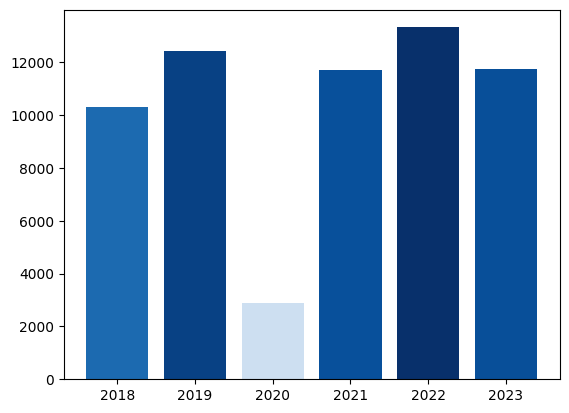

In [24]:
gradiente = df_ano/df_ano.max()
cores = plt.cm.Blues(gradiente)


plt.bar(df_ano.index, df_ano.values, color = cores)
plt.show()

#### Dados da aula no youtube do Didatica Tech link  https://www.youtube.com/watch?v=iiCl4Xnl-CU